# **Implementing the libraries required**

In [13]:
%pip install opencv-python

Note: you may need to restart the kernel to use updated packages.


In [14]:
pip install matplotlib

Note: you may need to restart the kernel to use updated packages.


In [15]:
import numpy as np
import time
import cv2
import os
from os import listdir
from os.path import isfile, join
from matplotlib import pyplot as plt

# **Defining a plot function to plot the images **

In [16]:
def plot( title , image = None , size = 10):
  width, height = image.shape[0] , image.shape[1]
  aspect_ratio = width/height
  plt.figure(figsize=(size * aspect_ratio,size))
  plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
  plt.title(title)
  plt.show()

# **Unziping the neural style transfer code**

In [17]:
!unzip -qq NeuralStyleTransfer.zip

'unzip' is not recognized as an internal or external command,
operable program or batch file.


# **Implement Neural style transfer using pretrained models**

We have used here pretrained t7 PyTorch models that can be imported using ``cv2.dnn.readNetFromTouch()```

These models we're using come from the paper Perceptual Losses for Real-Time Style Transfer and Super-Resolution by Johnson et al.

They improved proposing a Neural Style Transfer algorithm that performed 3 times faster by using a super-resolution-like problem based on perceptual loss function.

1. Using Model: candy


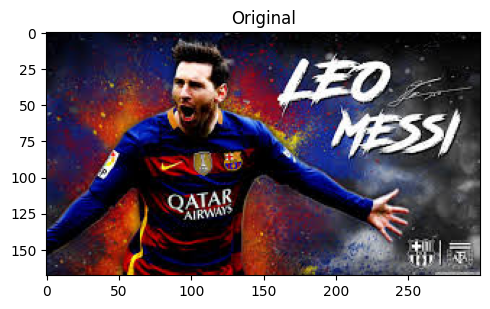

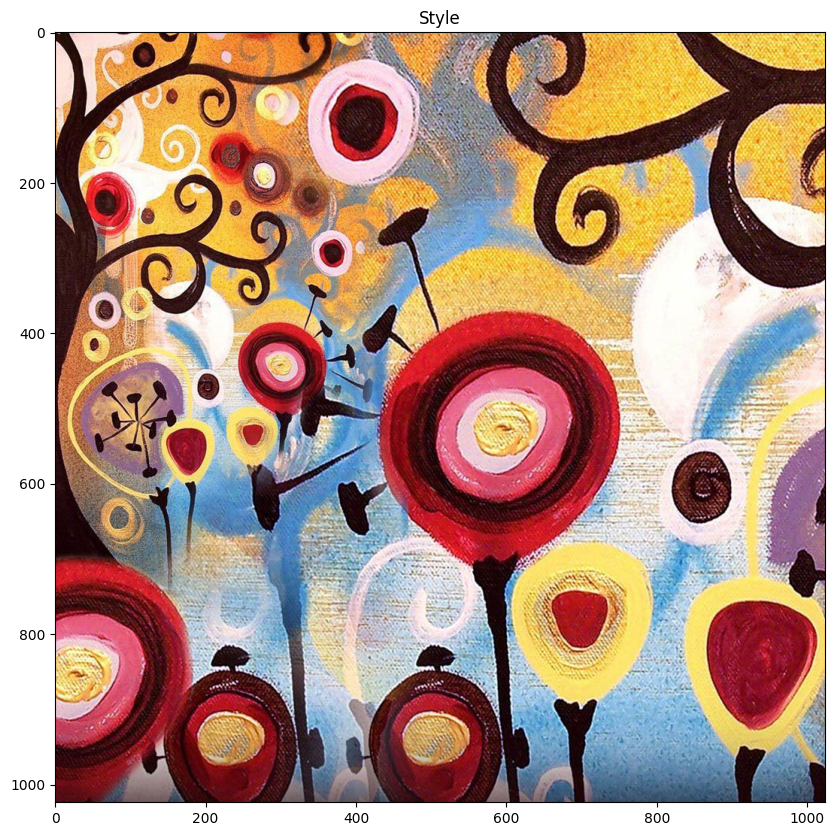

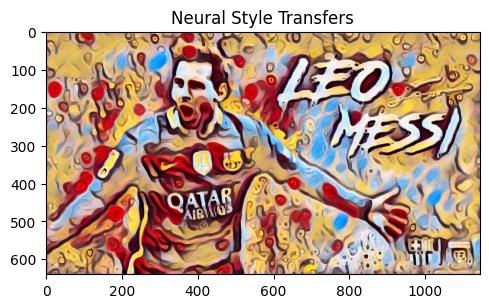

2. Using Model: composition_vii


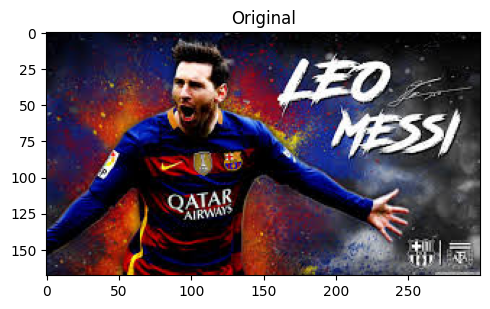

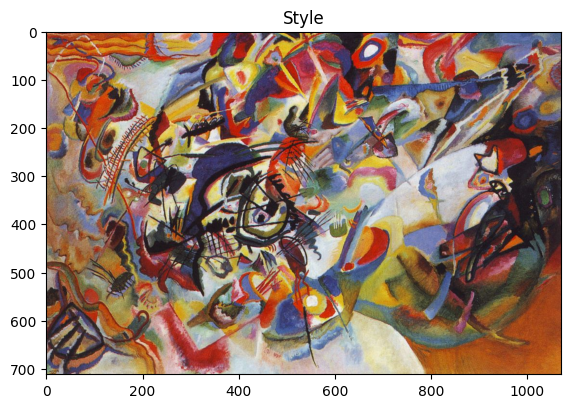

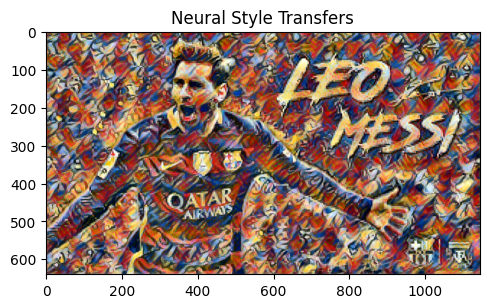

3. Using Model: feathers


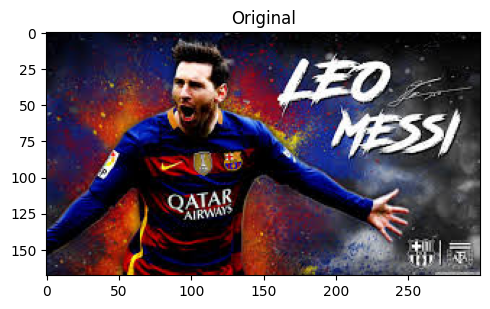

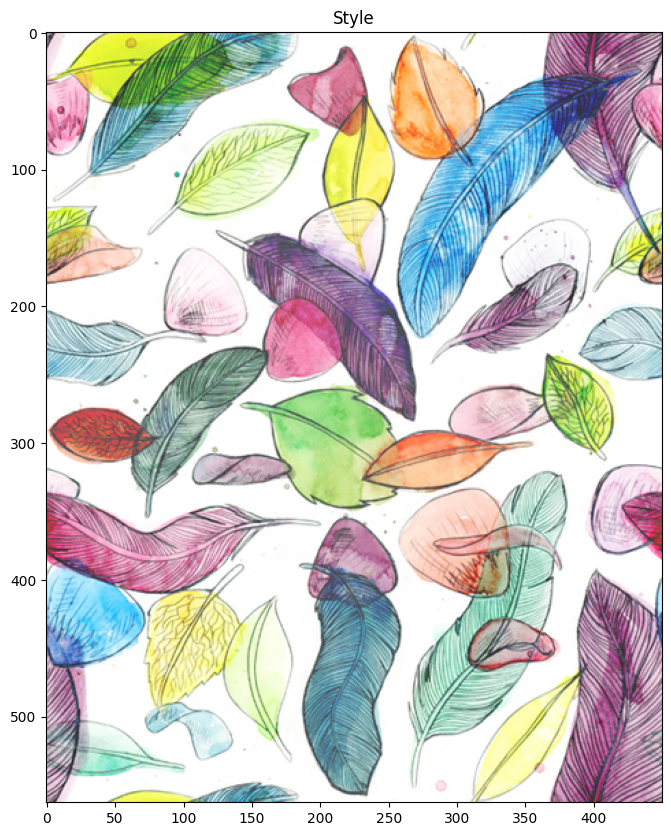

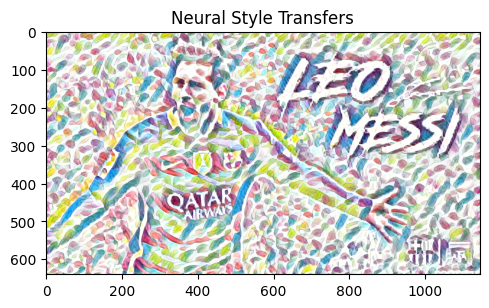

4. Using Model: la_muse


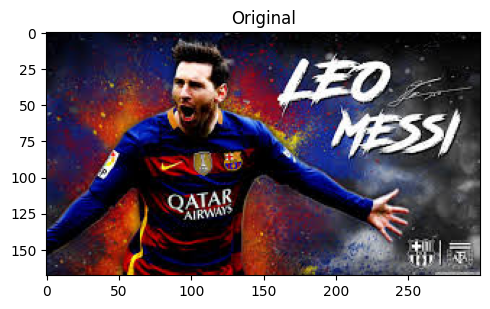

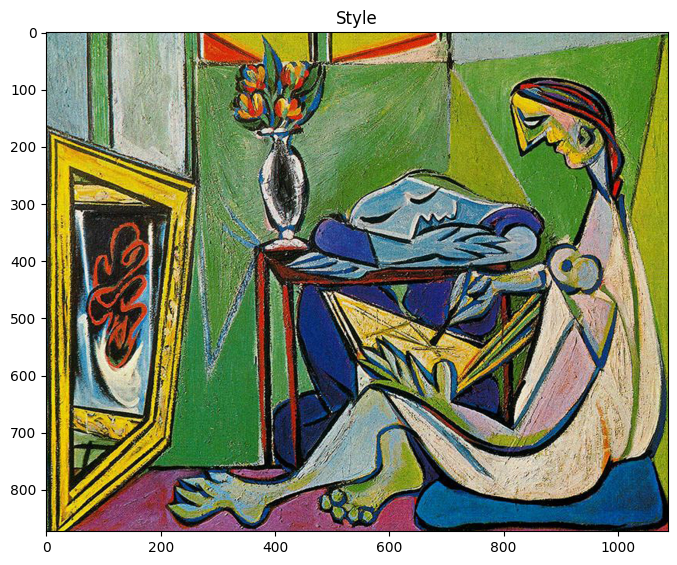

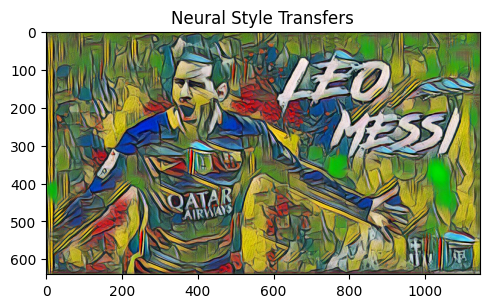

5. Using Model: mosaic


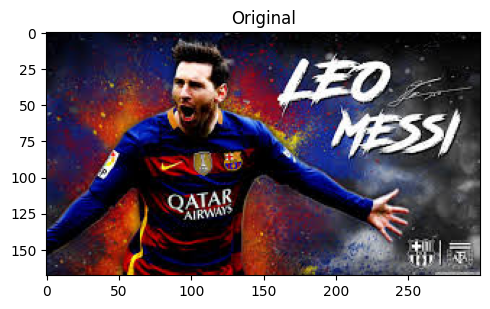

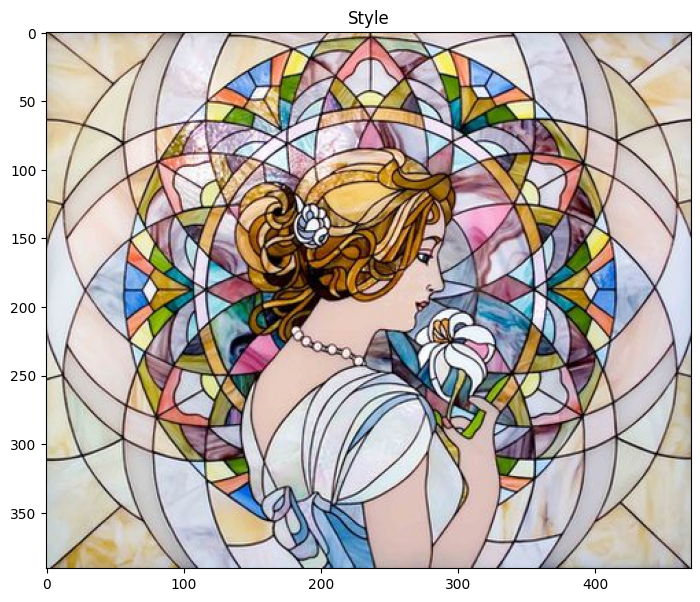

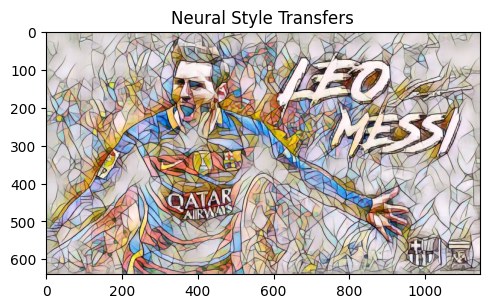

6. Using Model: starry_night


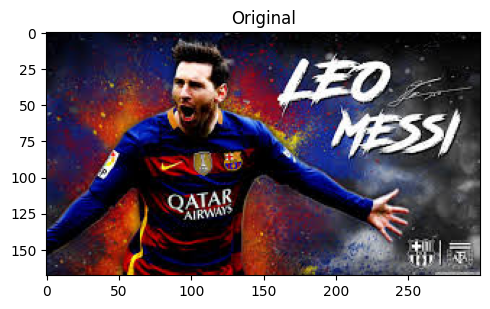

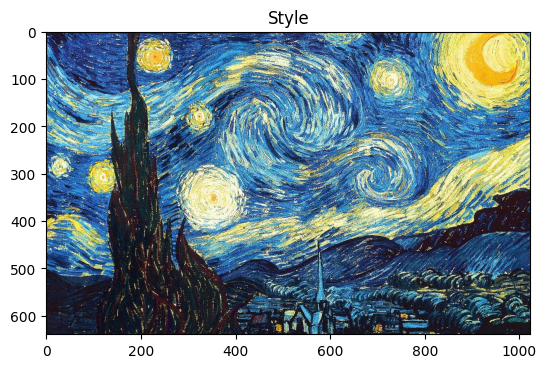

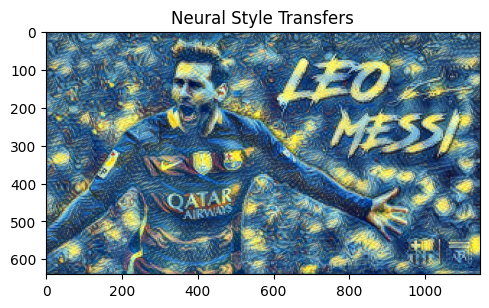

7. Using Model: the_scream


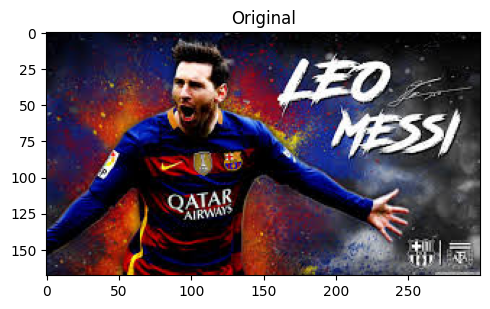

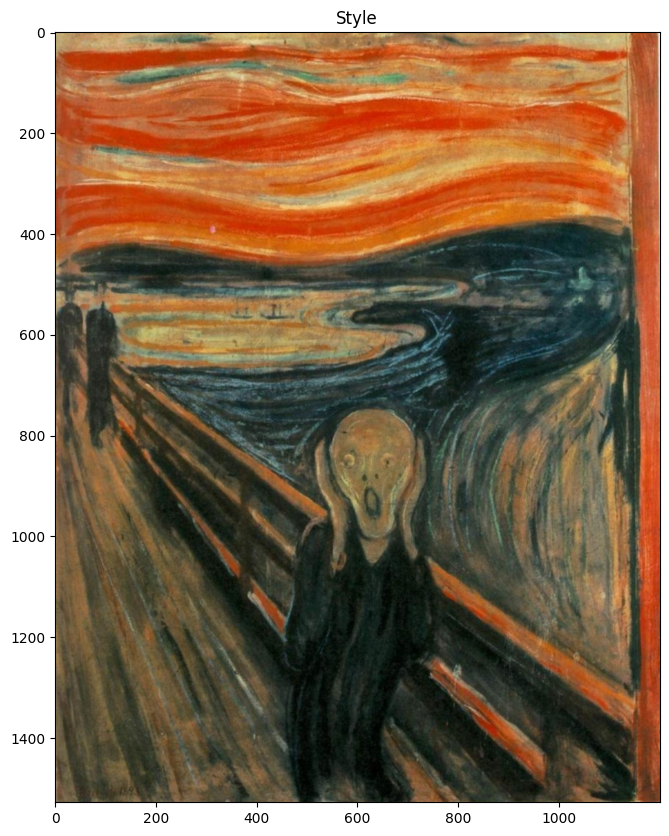

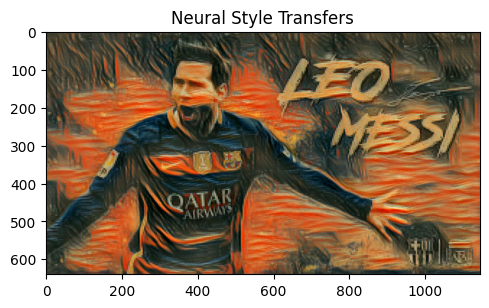

8. Using Model: the_wave


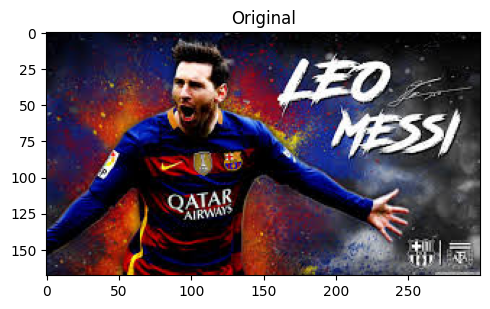

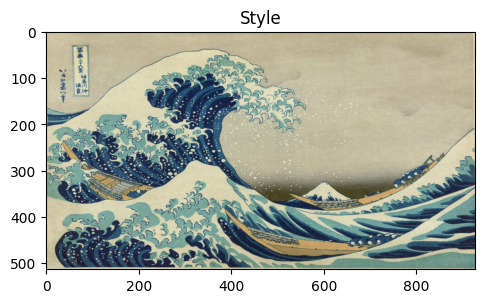

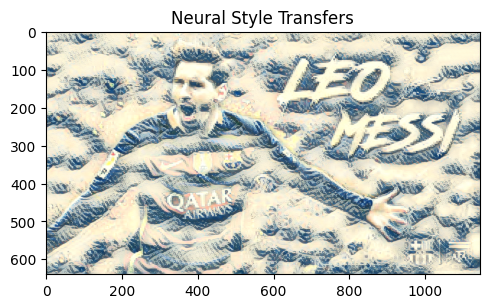

9. Using Model: udnie


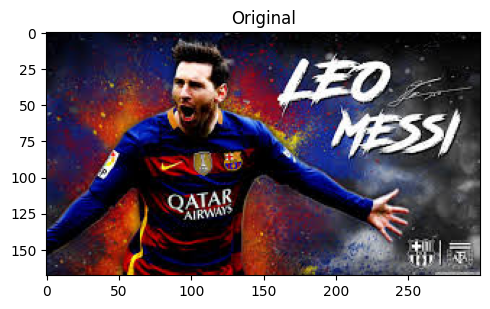

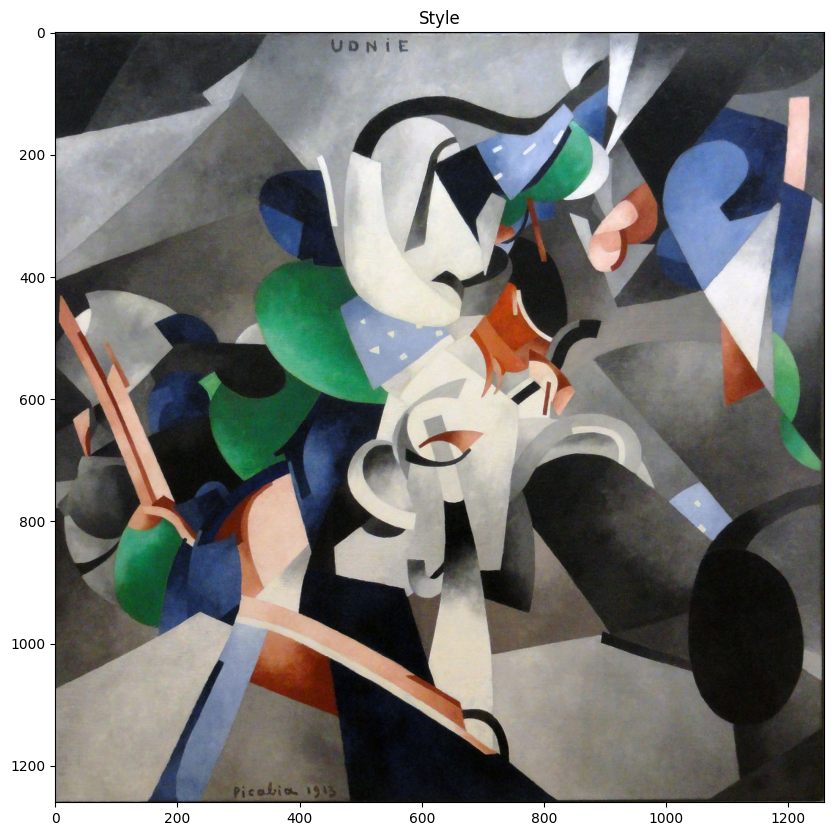

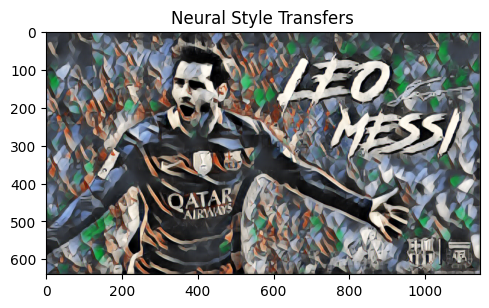

In [18]:
# Loading our t7 neural transfer models
model_file_path = "NeuralStyleTransfer/models/"
model_file_paths = [f for f in listdir(model_file_path) if isfile(join(model_file_path, f))]

# Loading our test image
img = cv2.imread("messi.jpg")

alpha = 0.5

# Looping through and applying each model styling our input image
for (i,model) in enumerate(model_file_paths):
    # printing the model being used
    print(str(i+1) + ". Using Model: " + str(model)[:-3])
    style = cv2.imread("NeuralStyleTransfer/art/"+str(model)[:-3]+".jpg")
    # loading our neural style transfer model
    neuralStyleModel = cv2.dnn.readNetFromTorch(model_file_path+ model)

    # resizing to a fixed height of 640 (feel free to change)
    height, width = int(img.shape[0]), int(img.shape[1])
    newWidth = int((640 / height) * width)
    resizedImg = cv2.resize(img, (newWidth, 640), interpolation = cv2.INTER_AREA)

    # Creating our blob from the image and then performing a forward pass run of the network
    inpBlob = cv2.dnn.blobFromImage(resizedImg, 1.0, (newWidth, 640), (103.939, 116.779, 123.68), swapRB=False, crop=False)

    neuralStyleModel.setInput(inpBlob)
    output = neuralStyleModel.forward()

    # Reshaping the output tensor, adding back  the mean subtraction and re-ordering the channels
    output = output.reshape(3, output.shape[2], output.shape[3])
    output[0] += 103.939
    output[1] += 116.779
    output[2] += 123.68
    output /= 255
    output = output.transpose(1, 2, 0)
    output = np.clip(output, 0, 1)  # Ensure the output is in the valid range

    # Blending the original and stylized images
    # blended_output = cv2.addWeighted(resizedImg, 1 - alpha, output * 255, alpha, 0)

    #Displaying our original image, the style being applied and the final Neural Style Transfer
    plot("Original", img)
    plot("Style", style)
    plot("Neural Style Transfers", output)

# **Using the ECCV16 Updated NST Algorithm**

In Ulyanov et al.’s 2017 publication, Instance Normalization: The Missing Ingredient for Fast Stylization, it was found that swapping batch normalization for instance normalization (and applying instance normalization at both training and testing), leads to even faster real-time performance and arguably more aesthetically pleasing results as well.

Let's now use the models used by Johnson et al. in their ECCV paper.

1. Using Model: composition_vii


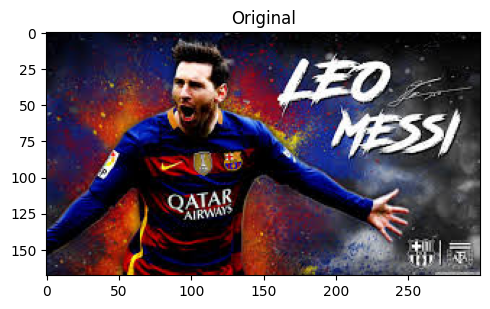

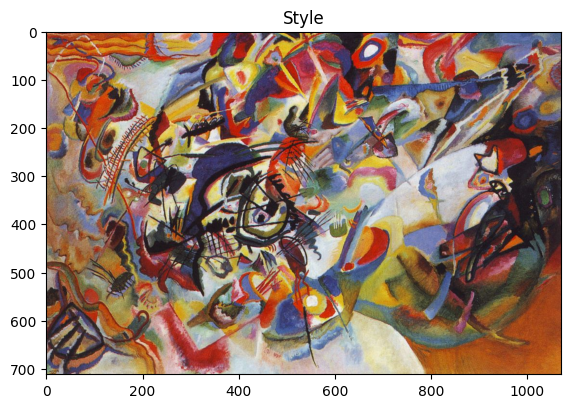

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.16381928..1.0679916].


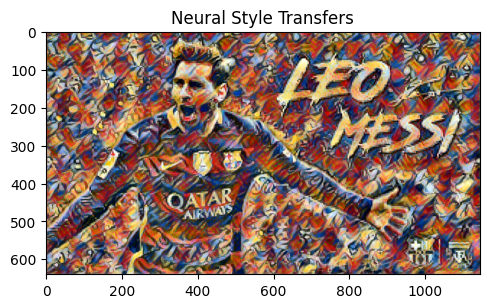

2. Using Model: la_muse


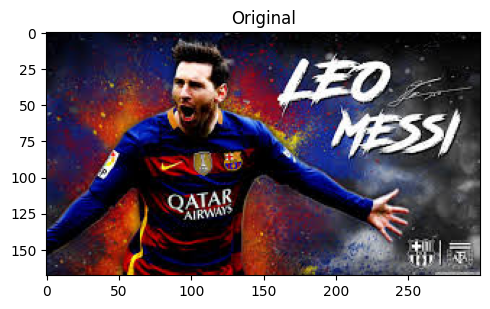

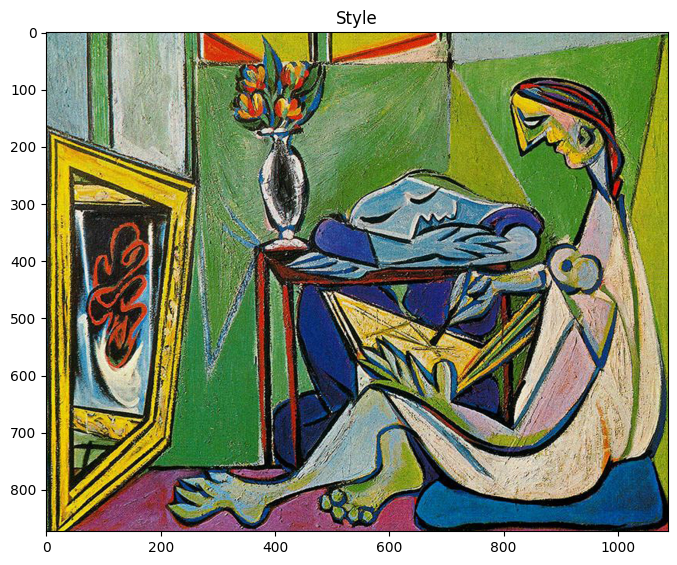

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.17944926..1.0728014].


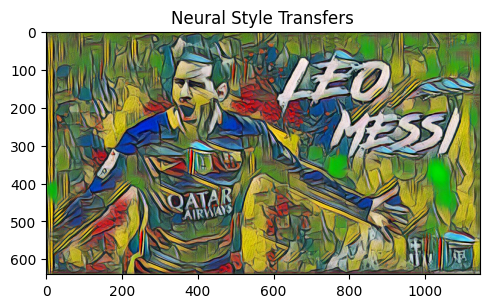

3. Using Model: starry_night


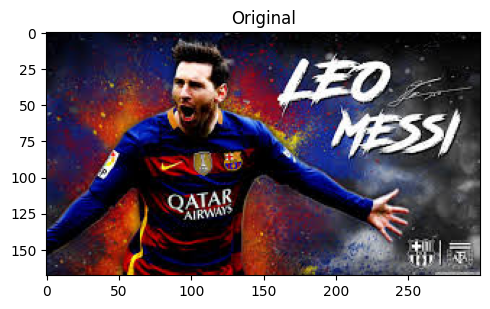

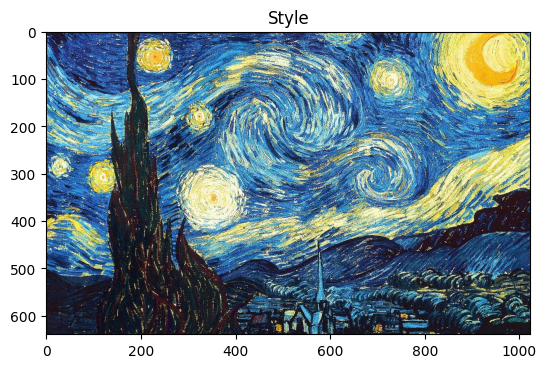

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.15406586..1.0731031].


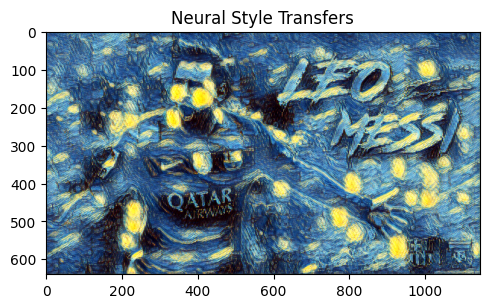

4. Using Model: the_wave


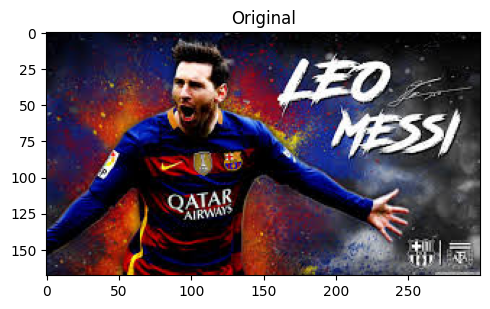

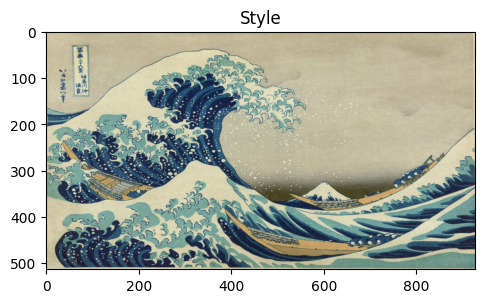

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.015107548..1.0729809].


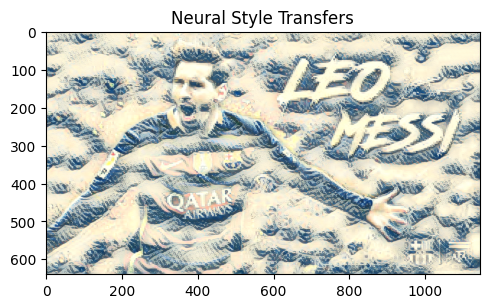

In [19]:
# Loading our t7 neural transfer models
model_file_path = "NeuralStyleTransfer/models/ECCV16/"
model_file_paths = [f for f in listdir(model_file_path) if isfile(join(model_file_path, f))]

# Loading our test image
img = cv2.imread("messi.jpg")

# Looping through and applying each model style our input image
for (i,model) in enumerate(model_file_paths):
    # print the model being used
    print(str(i+1) + ". Using Model: " + str(model)[:-3])
    style = cv2.imread("NeuralStyleTransfer/art/"+str(model)[:-3]+".jpg")
    # loading our neural style transfer model
    neuralStyleModel = cv2.dnn.readNetFromTorch(model_file_path+ model)

    # resizing to a fixed height of 640 (need not necessarily be fixed,feel free to change)
    height, width = int(img.shape[0]), int(img.shape[1])
    newWidth = int((640 / height) * width)
    resizedImg = cv2.resize(img, (newWidth, 640), interpolation = cv2.INTER_AREA)

    # Creating our blob from the image and then performing a forward pass run of the network
    inpBlob = cv2.dnn.blobFromImage(resizedImg, 1.0, (newWidth, 640), (103.939, 116.779, 123.68), swapRB=False, crop=False)

    neuralStyleModel.setInput(inpBlob)
    output = neuralStyleModel.forward()

    # Reshaping the output tensor, adding back  the mean subtraction and re-ordering the channels
    output = output.reshape(3, output.shape[2], output.shape[3])
    output[0] += 103.939
    output[1] += 116.779
    output[2] += 123.68
    output /= 255
    output = output.transpose(1, 2, 0)

    #Displaying our original image, the style being applied and the final Neural Style Transfer
    plot("Original", img)
    plot("Style", style)
    plot("Neural Style Transfers", output)

# **We could also try and test this on a .mp4 video say**

In [20]:
# Loading our t7 neural transfer models
model_file_path = "NeuralStyleTransfer/models/ECCV16/starry_night.t7"

# Loading video stream, long clip
cap = cv2.VideoCapture('dj.mp4')

# Getting the height and width of the frame (required to be an interger)
w = int(cap.get(3))
h = int(cap.get(4))

# Defining the codec and create VideoWriter object. The output is stored in '*.avi' file.
out = cv2.VideoWriter('NST_Starry_Night.avi', cv2.VideoWriter_fourcc('M','J','P','G'), 30, (w, h))

# Looping through and applying each model style our input image
#for (i,model) in enumerate(model_file_paths):
#this for loop can be uncommemted, here I am just checking out this algorithm for starry nights.
style = cv2.imread("NeuralStyleTransfer/art/starry_night.jpg")
i = 0
while(1):

    ret, img = cap.read()

    if ret == True:
      i += 1
      print("Completed {} Frame(s)".format(i))
      # loading our neural style transfer model
      neuralStyleModel = cv2.dnn.readNetFromTorch(model_file_path)

      # Resizing to a fixed height of 640 (feel free to change)
      height, width = int(img.shape[0]), int(img.shape[1])
      newWidth = int((640 / height) * width)
      resizedImg = cv2.resize(img, (newWidth, 640), interpolation = cv2.INTER_AREA)

      # Creating our blob from the image and then perform a forward pass run of the network
      inpBlob = cv2.dnn.blobFromImage(resizedImg, 1.0, (newWidth, 640),
                                (103.939, 116.779, 123.68), swapRB=False, crop=False)

      neuralStyleModel.setInput(inpBlob)
      output = neuralStyleModel.forward()

      # Reshaping the output tensor, adding back  the mean subtraction
      # and re-ordering the channels
      output = output.reshape(3, output.shape[2], output.shape[3])
      output[0] += 103.939
      output[1] += 116.779
      output[2] += 123.68
      output /= 255
      output = output.transpose(1, 2, 0)

      #Display our original image, the style being applied and the final Neural Style Transfer
      #imshow("Original", img)
      #imshow("Style", style)
      #imshow("Neural Style Transfers", output)
      vid_output = (output * 255).astype(np.uint8)
      vid_output = cv2.resize(vid_output, (w, h), interpolation = cv2.INTER_AREA)
      out.write(vid_output)
    else:
      break

cap.release()
out.release()

Completed 1 Frame(s)
Completed 2 Frame(s)
Completed 3 Frame(s)
Completed 4 Frame(s)
Completed 5 Frame(s)
Completed 6 Frame(s)
Completed 7 Frame(s)
Completed 8 Frame(s)
Completed 9 Frame(s)
Completed 10 Frame(s)
Completed 11 Frame(s)
Completed 12 Frame(s)
Completed 13 Frame(s)
Completed 14 Frame(s)
Completed 15 Frame(s)
Completed 16 Frame(s)
Completed 17 Frame(s)
Completed 18 Frame(s)
Completed 19 Frame(s)
Completed 20 Frame(s)
Completed 21 Frame(s)
Completed 22 Frame(s)
Completed 23 Frame(s)
Completed 24 Frame(s)
Completed 25 Frame(s)
Completed 26 Frame(s)
Completed 27 Frame(s)
Completed 28 Frame(s)
Completed 29 Frame(s)
Completed 30 Frame(s)
Completed 31 Frame(s)
Completed 32 Frame(s)
Completed 33 Frame(s)


In [21]:
%pip install ffmpeg

Note: you may need to restart the kernel to use updated packages.


In [22]:
!ffmpeg -i NST_Starry_Night.avi -c:v libx264 -c:a aac NST_Starry_Night.mp4 -y


ffmpeg version N-118616-g3e9777dc75-20250304 Copyright (c) 2000-2025 the FFmpeg developers
  built with gcc 14.2.0 (crosstool-NG 1.27.0.18_7458341)
  configuration: --prefix=/ffbuild/prefix --pkg-config-flags=--static --pkg-config=pkg-config --cross-prefix=x86_64-w64-mingw32- --arch=x86_64 --target-os=mingw32 --enable-gpl --enable-version3 --disable-debug --enable-shared --disable-static --disable-w32threads --enable-pthreads --enable-iconv --enable-zlib --enable-libfreetype --enable-libfribidi --enable-gmp --enable-libxml2 --enable-lzma --enable-fontconfig --enable-libharfbuzz --enable-libvorbis --enable-opencl --disable-libpulse --enable-libvmaf --disable-libxcb --disable-xlib --enable-amf --enable-libaom --enable-libaribb24 --enable-avisynth --enable-chromaprint --enable-libdav1d --enable-libdavs2 --enable-libdvdread --enable-libdvdnav --disable-libfdk-aac --enable-ffnvcodec --enable-cuda-llvm --enable-frei0r --enable-libgme --enable-libkvazaar --enable-libaribcaption --enable-libas

In [23]:
from IPython.display import HTML
from base64 import b64encode

video_path = 'NST_Starry_Night.mp4'

mp4 = open(video_path, "rb").read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML(f"""
<video width=600 controls><source src="{data_url}" type="video/mp4">
</video>""")